In [2]:
import scanpy as scp
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import os
from datetime import datetime

from auxiliar import *

# Select dataset

In [3]:
dataset = "data_processed"

In [4]:
dataset_name = f"full"

In [ ]:
adatas = []
for file in np.sort([os.path.join(dataset,i) for i in os.listdir(dataset) if "rep" in i]):
    adata = scp.read_h5ad(file)
    adata.obs["sample"] = file.split(".")[0].split("adata_")[-1]
    adata.obs["condition"] = file.split(".")[0].split("adata_")[-1].split("_rep")[0]
    adatas.append(adata.copy())

adata = scp.concat(adatas)
adata.var = adatas[0].var.loc[:,["gene_id","gene_name","gene_type"]]
adata.var_names = adatas[0].var_names
adata.obs["sample"] = adata.obs["sample"].astype("category")
adata.obs["sample"] = adata.obs["sample"].cat.reorder_categories(np.sort(adata.obs["sample"].unique()))
adata.X = adata.layers["counts"].copy()

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [5]:
parameters = pd.read_csv("parameters_full.csv", index_col=0).loc[dataset_name, :].to_dict()
print("Parameters: ")
parameters

Parameters: 


{'n_top_genes': 2000,
 'n_top_genes.1': 2000,
 'n_pcs': 30,
 'n_neighbors': 15,
 'cell_cycle_regression': True,
 'resolutions': '[0.1,0.2,0.5,1]'}

In [6]:
if not os.path.exists(f"figures/{dataset_name}"):
    os.makedirs(f"figures/{dataset_name}")

if not os.path.exists(f"tables/{dataset_name}"):
    os.makedirs(f"tables/{dataset_name}")

if not os.path.exists('script_versions'):
    os.makedirs('script_versions')

# QC

Text(0.5, 1.0, 'Percentage of mitochondrial genes')

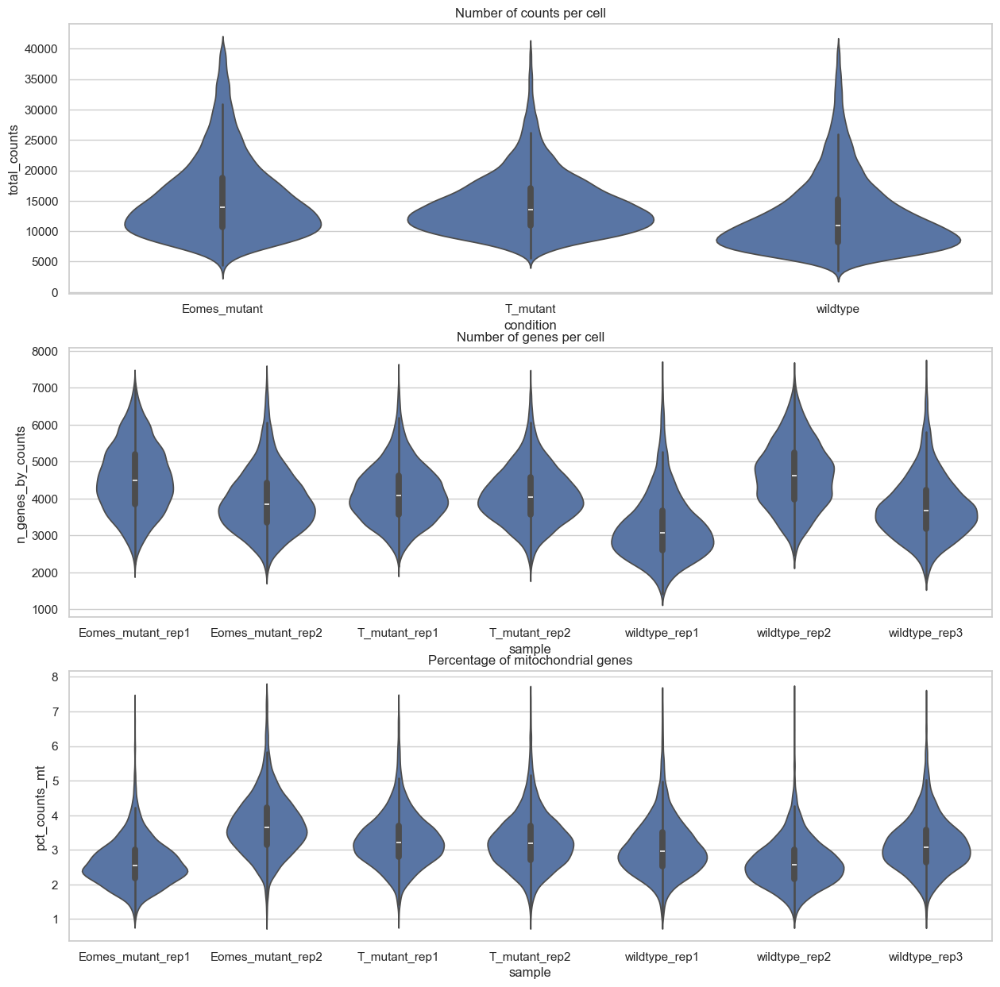

In [ ]:
fig, ax = plt.subplots(3,1, figsize=(15,15))

sns.violinplot(data=adata.obs, x="condition", y="total_counts", ax=ax[0])
ax[0].set_title("Number of counts per cell")

sns.violinplot(data=adata.obs, x="sample", y="n_genes_by_counts", ax=ax[1])
ax[1].set_title("Number of genes per cell")

sns.violinplot(data=adata.obs, x="sample", y="pct_counts_mt", ax=ax[2])
ax[2].set_title("Percentage of mitochondrial genes")

# Normalization

In [ ]:
scp.pp.normalize_total(adata)
scp.pp.log1p(adata)

# Dimensionality reduction

## Feature selection

In [ ]:
scp.pp.highly_variable_genes(adata, n_top_genes=parameters["n_top_genes"])

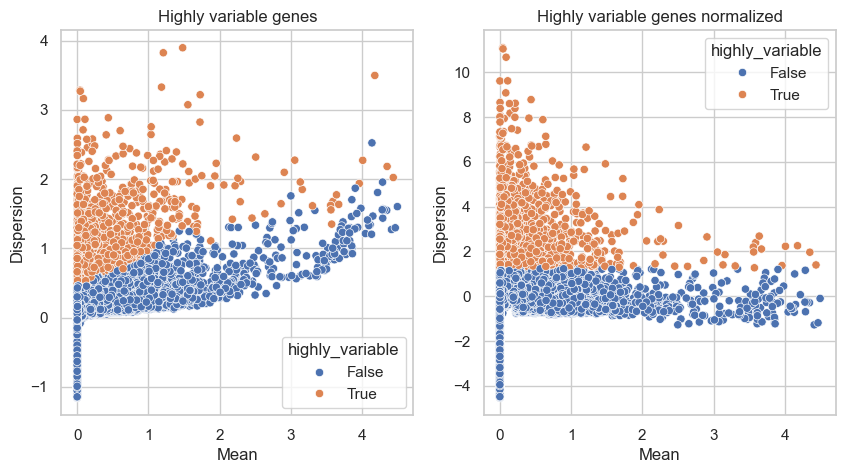

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

sns.scatterplot(x="means", y="dispersions", hue="highly_variable", data=adata.var, ax=ax[0])
ax[0].set_title("Highly variable genes")
ax[0].set_xlabel("Mean")
ax[0].set_ylabel("Dispersion")

sns.scatterplot(x="means", y="dispersions_norm", hue="highly_variable", data=adata.var, ax=ax[1])
ax[1].set_title("Highly variable genes normalized")
ax[1].set_xlabel("Mean")
ax[1].set_ylabel("Dispersion")

fig.savefig(f"figures/{dataset_name}/highly_variable_genes.png", bbox_inches="tight", transparent=True, dpi=300)

## PCA

In [ ]:
scp.pp.pca(adata, n_comps=100, use_highly_variable=True)

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


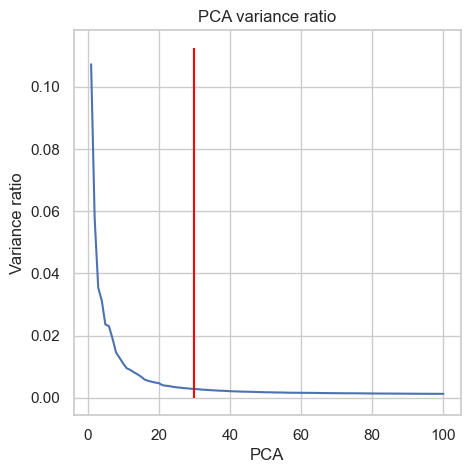

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))

sns.lineplot(x=range(1, 101), y=adata.uns["pca"]["variance_ratio"], ax=ax)
ax.vlines(parameters["n_pcs"], 0, ax.get_ylim()[1], color="red", label="min")
ax.set_title("PCA variance ratio")
ax.set_xlabel("PCA")
ax.set_ylabel("Variance ratio")

fig.savefig(f"figures/{dataset_name}/pca_variance_ratio.png", bbox_inches="tight", transparent=True, dpi=300)

In [ ]:
scp.pp.pca(adata, n_comps=parameters["n_pcs"], use_highly_variable=True)

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


## UMAP

In [ ]:
scp.pp.neighbors(adata, use_rep="X_pca", key_added="neighbors_pca", n_neighbors=parameters["n_neighbors"], n_pcs=parameters["n_pcs"])
scp.tl.umap(adata, neighbors_key="neighbors_pca")
adata.obsm["X_umap_pca"] = adata.obsm["X_umap"]

# Corrections

## Batch correction

In [ ]:
scp.external.pp.harmony_integrate(adata, key="sample", basis="X_pca", adjusted_basis="X_pca_sample")

2025-03-19 11:19:36,559 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


2025-03-19 11:19:40,199 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-19 11:19:40,270 - harmonypy - INFO - Iteration 1 of 10
2025-03-19 11:19:51,067 - harmonypy - INFO - Iteration 2 of 10
2025-03-19 11:20:00,923 - harmonypy - INFO - Iteration 3 of 10
2025-03-19 11:20:10,384 - harmonypy - INFO - Iteration 4 of 10
2025-03-19 11:20:21,218 - harmonypy - INFO - Converged after 4 iterations


In [ ]:
scp.pp.neighbors(adata, use_rep="X_pca_sample", key_added="neighbors_pca_sample", n_neighbors=parameters["n_neighbors"], n_pcs=parameters["n_pcs"])
scp.tl.umap(adata, neighbors_key="neighbors_pca_sample")
adata.obsm["X_umap_pca_sample"] = adata.obsm["X_umap"]

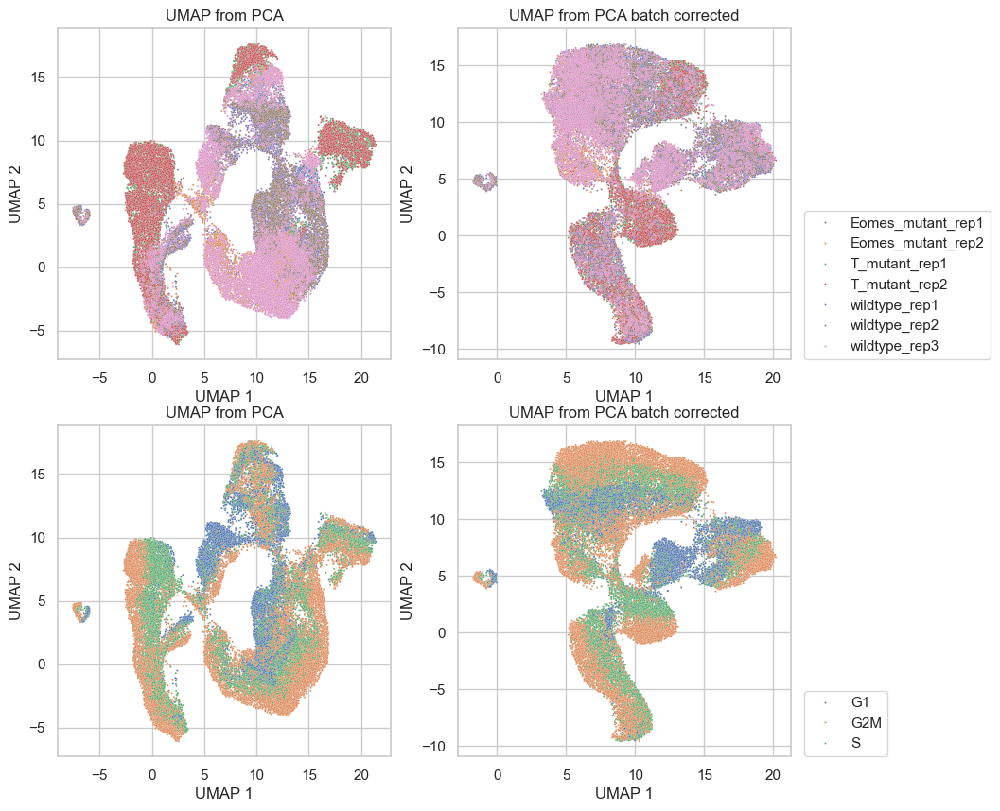

In [ ]:
fig, ax = plt.subplots(2, 2, figsize=(10, 10))

X = adata.obsm["X_umap_pca"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["sample"], s=2, ax=ax[0,0])
ax[0,0].set_title("UMAP from PCA")
ax[0,0].set_xlabel("UMAP 1")
ax[0,0].set_ylabel("UMAP 2")
ax[0,0].get_legend().remove()

X = adata.obsm["X_umap_pca_sample"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["sample"], s=2, ax=ax[0,1])
ax[0,1].set_title("UMAP from PCA batch corrected")
ax[0,1].set_xlabel("UMAP 1")
ax[0,1].set_ylabel("UMAP 2")
ax[0,1].legend(loc=(1.04,0))

X = adata.obsm["X_umap_pca"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["phase"], s=2, ax=ax[1,0])
ax[1,0].set_title("UMAP from PCA")
ax[1,0].set_xlabel("UMAP 1")
ax[1,0].set_ylabel("UMAP 2")
ax[1,0].get_legend().remove()

X = adata.obsm["X_umap_pca_sample"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["phase"], s=2, ax=ax[1,1])
ax[1,1].set_title("UMAP from PCA batch corrected")
ax[1,1].set_xlabel("UMAP 1")
ax[1,1].set_ylabel("UMAP 2")
ax[1,1].legend(loc=(1.04,0))

fig.savefig(f"figures/{dataset_name}/umap_pca_vs_pca_sample.png", bbox_inches="tight", transparent=True, dpi=300)

## Cell cycle correction

In [ ]:
s_genes = [i for i in pd.read_csv("cell_cycle_G1_S.txt",header=None).values.flatten() if i in adata.var_names]
g2m_genes = [i for i in pd.read_csv("cell_cycle_G2_M.txt",header=None).values.flatten() if i in adata.var_names]

cycle_genes = s_genes+g2m_genes

In [ ]:
scp.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

scp.external.pp.harmony_integrate(adata, "phase", basis="X_pca_sample", adjusted_basis="X_pca_sample_phase")

2025-03-19 11:20:45,079 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-19 11:20:49,745 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-19 11:20:49,816 - harmonypy - INFO - Iteration 1 of 10
2025-03-19 11:20:58,910 - harmonypy - INFO - Iteration 2 of 10
2025-03-19 11:21:04,168 - harmonypy - INFO - Iteration 3 of 10
2025-03-19 11:21:09,300 - harmonypy - INFO - Converged after 3 iterations


In [ ]:
scp.pp.neighbors(adata, use_rep="X_pca_sample_phase", key_added="neighbors_pca_sample_phase", n_neighbors=parameters["n_neighbors"], n_pcs=parameters["n_pcs"])
scp.tl.umap(adata, neighbors_key="neighbors_pca_sample_phase")
adata.obsm["X_umap_pca_sample_phase"] = adata.obsm["X_umap"]

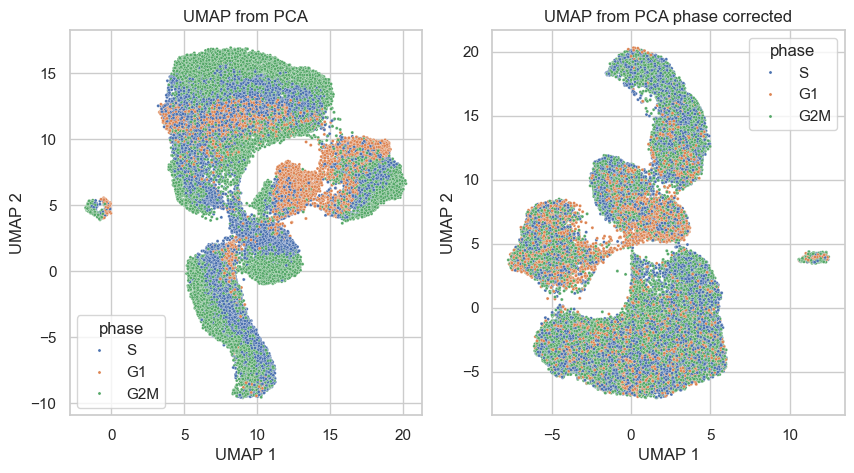

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

X = adata.obsm["X_umap_pca_sample"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["phase"], s=5, ax=ax[0])
ax[0].set_title("UMAP from PCA")
ax[0].set_xlabel("UMAP 1")
ax[0].set_ylabel("UMAP 2")

X = adata.obsm["X_umap_pca_sample_phase"]
sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs["phase"], s=5, ax=ax[1])
ax[1].set_title("UMAP from PCA phase corrected")
ax[1].set_xlabel("UMAP 1")
ax[1].set_ylabel("UMAP 2")

fig.savefig(f"figures/{dataset_name}/umap_pca_vs_pca_phase.png", bbox_inches="tight", transparent=True, dpi=300)

In [ ]:
if parameters["cell_cycle_regression"]:
    repr = "pca_sample_phase"
else:
    repr = "pca_sample"

## Plots highlight samples

In [7]:
adata = scp.read(f"data_processed/adata_{dataset_name}.h5ad")

/Users/gatocor/miniforge3/envs/scrnaseq_vitamin_a/lib/python3.13/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [8]:
adata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,doublet_score,predicted_doublet,S_score,G2M_score,phase,leiden_0.5,sample,condition,leiden_0.1,leiden_0.2,leiden_1
257,4938,20678.0,596.0,2.882290,0.034921,False,0.388731,0.212975,S,1,Eomes_mutant_rep1,Eomes_mutant,0,0,8
555,3616,11482.0,262.0,2.281832,0.021298,False,-0.102343,-0.244258,G1,1,Eomes_mutant_rep1,Eomes_mutant,0,0,6
616,4766,17295.0,290.0,1.676785,0.026172,False,0.516578,-0.114396,S,1,Eomes_mutant_rep1,Eomes_mutant,0,0,8
962,3420,11228.0,307.0,2.734236,0.017241,False,-0.041819,0.048093,G2M,2,Eomes_mutant_rep1,Eomes_mutant,3,3,0
1214,3731,15252.0,287.0,1.881721,0.036411,False,0.167079,0.262295,G2M,5,Eomes_mutant_rep1,Eomes_mutant,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921296,3440,8962.0,413.0,4.608346,0.049447,False,-0.018575,0.503412,G2M,0,wildtype_rep3,wildtype,0,1,1
921301,5333,20459.0,672.0,3.284618,0.067821,False,0.386001,0.196498,S,1,wildtype_rep3,wildtype,0,0,6
921497,7161,34902.0,1213.0,3.475446,0.058670,False,0.050416,0.262632,G2M,6,wildtype_rep3,wildtype,1,2,7
921765,3242,8943.0,337.0,3.768310,0.018842,False,0.075173,-0.144147,S,1,wildtype_rep3,wildtype,0,0,8


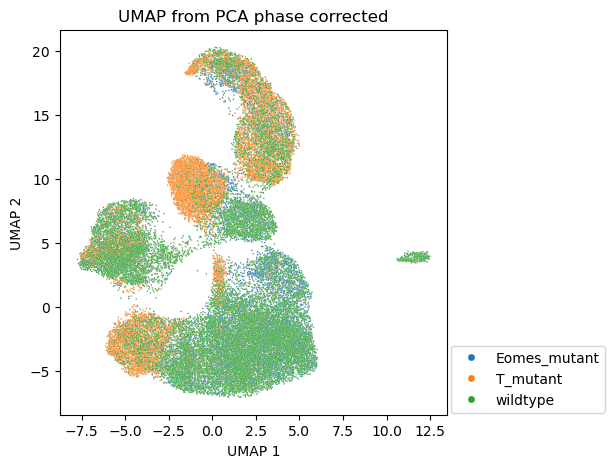

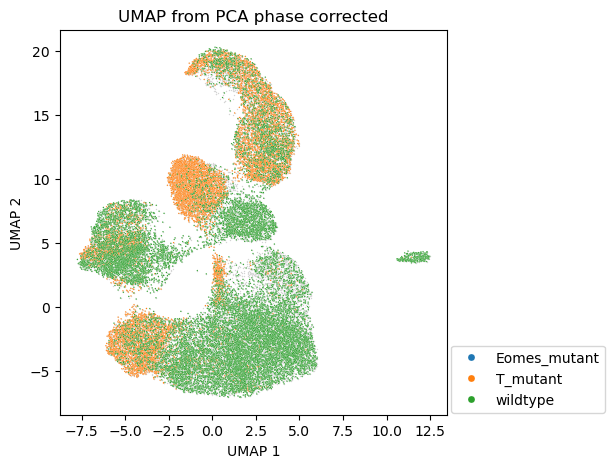

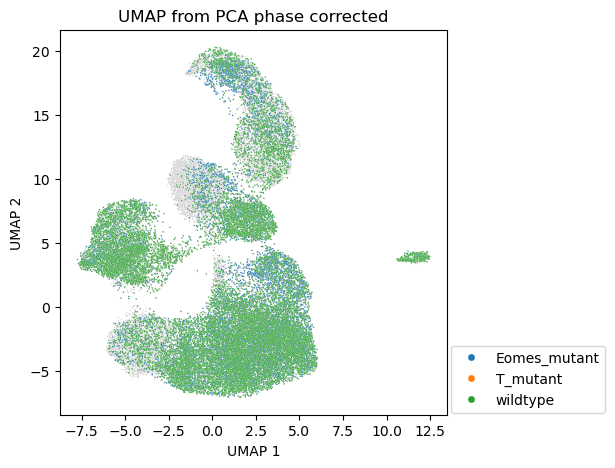

In [28]:
highlight_clusters = [
    ("Eomes_mutant", "T_mutant", "wildtype"),
    ("T_mutant", "wildtype"),
    ("Eomes_mutant", "wildtype"),
    ]

for i in highlight_clusters:
    
    X = adata.obsm["X_umap_pca_sample_phase"]
    highlight = adata.obs["condition"].isin(i).values
    
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))

    sns.scatterplot(x=X[:, 0], y=X[:, 1], color="lightgray", s=1, ax=ax)
    sns.scatterplot(x=X[highlight, 0], y=X[highlight, 1], hue=adata.obs["condition"].values[highlight], s=1, ax=ax)
    ax.set_title("UMAP from PCA phase corrected")
    ax.set_xlabel("UMAP 1")
    ax.set_ylabel("UMAP 2")
    ax.legend(fontsize=10, loc=(1.01,0.005), markerscale=5)

    fig.savefig(f"figures/{dataset_name}/umap_pca_vs_pca_condition_{i}.png", bbox_inches="tight", transparent=True, dpi=300)

# Clustering

In [58]:
parameters["resolutions"] = eval(parameters["resolutions"])

In [59]:
for resolution in parameters["resolutions"]:
    scp.tl.leiden(adata, neighbors_key=f"neighbors_{repr}", resolution=resolution, key_added=f"leiden_{resolution}")

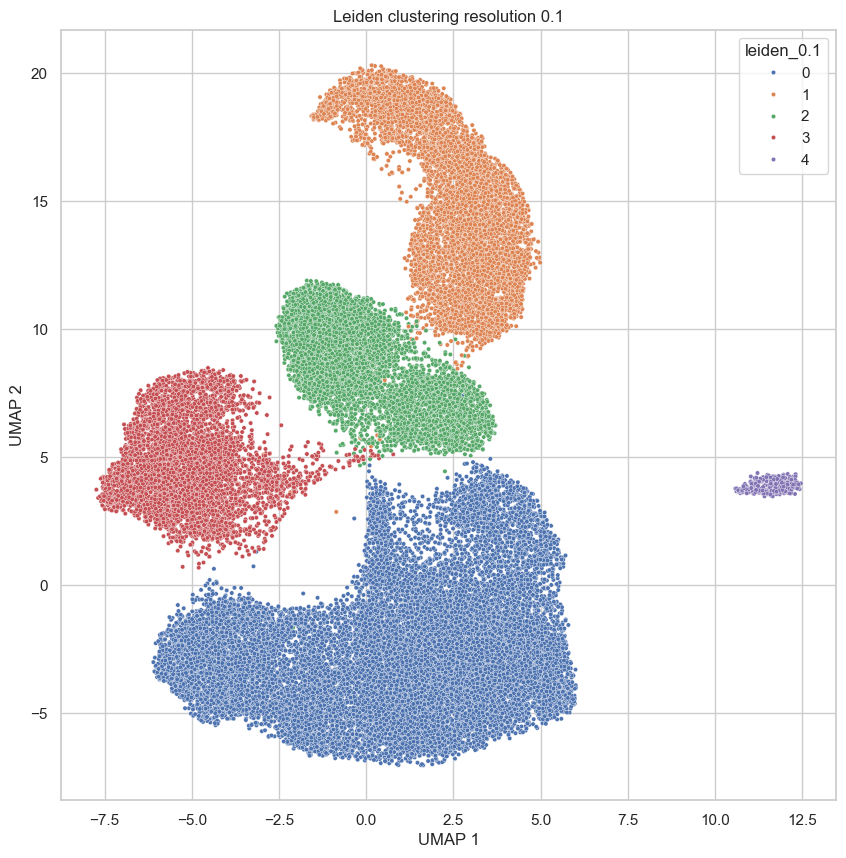

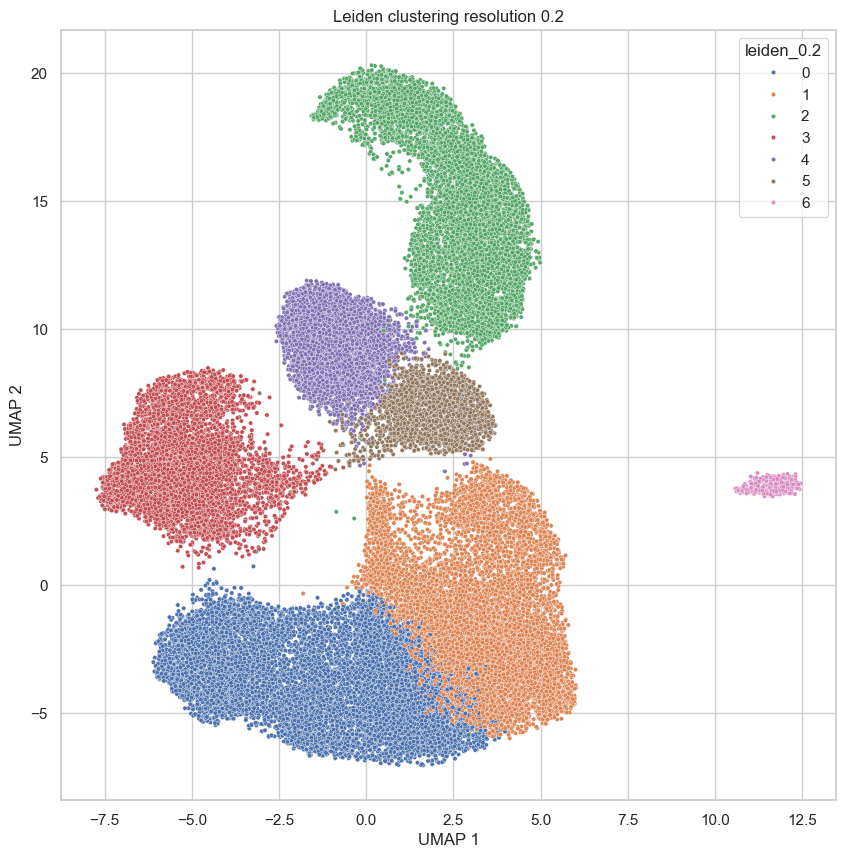

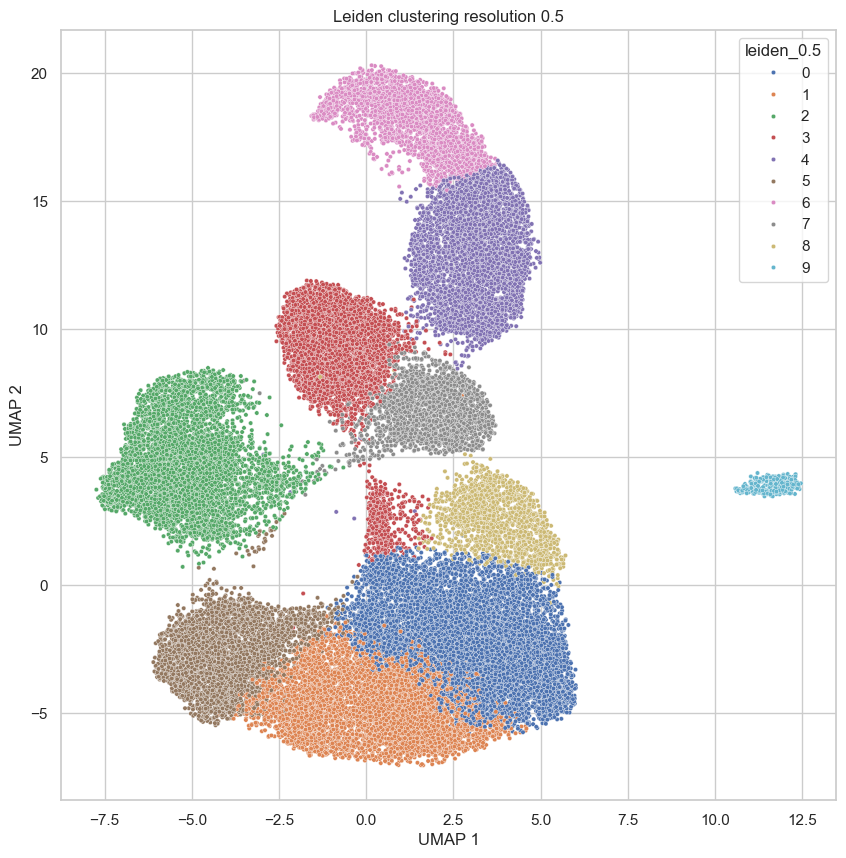

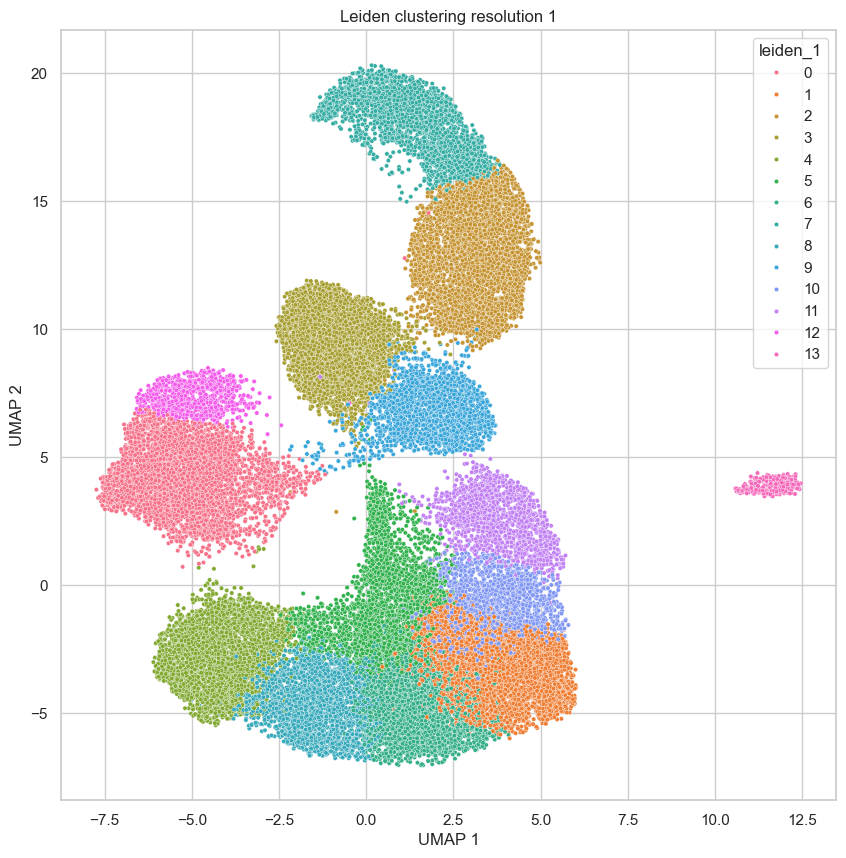

In [60]:
for resolution in parameters["resolutions"]:
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))

    X = adata.obsm[f"X_umap_{repr}"]
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=adata.obs[f"leiden_{resolution}"], s=10, ax=ax)
    ax.set_title(f"Leiden clustering resolution {resolution}")
    ax.set_xlabel("UMAP 1")
    ax.set_ylabel("UMAP 2")

    fig.savefig(f"figures/{dataset_name}/leiden_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

# Markers

## Dotplot

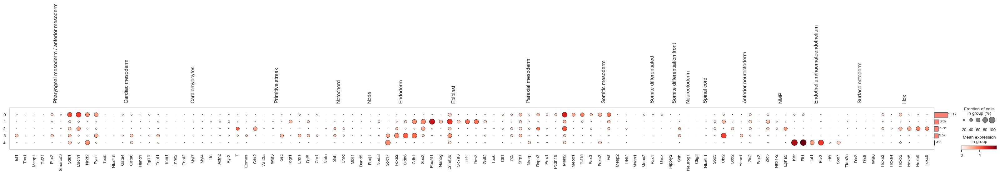

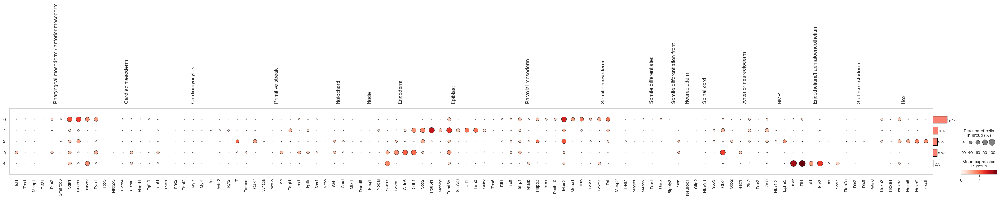

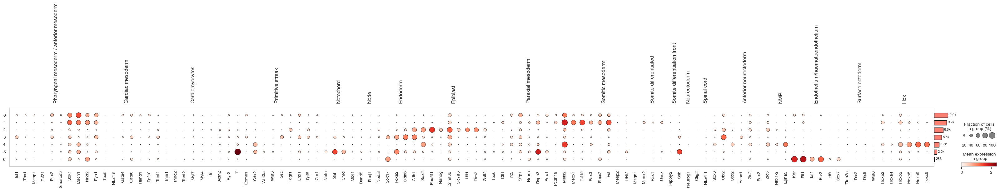

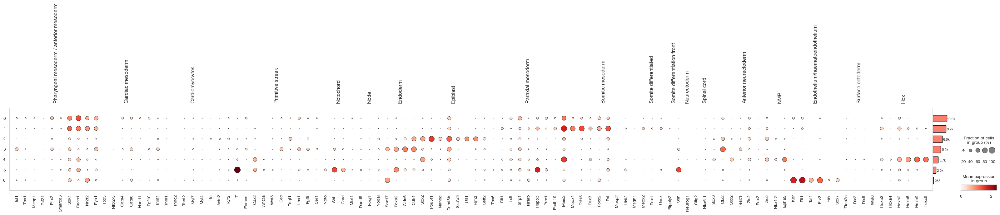

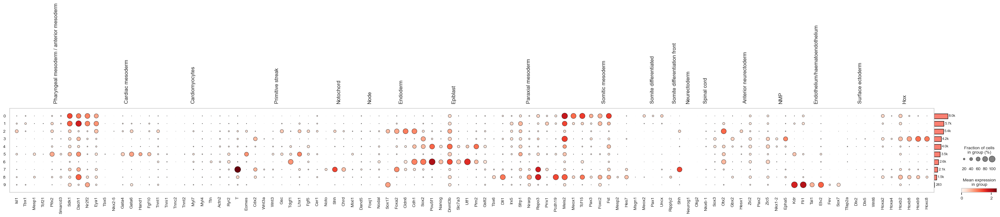

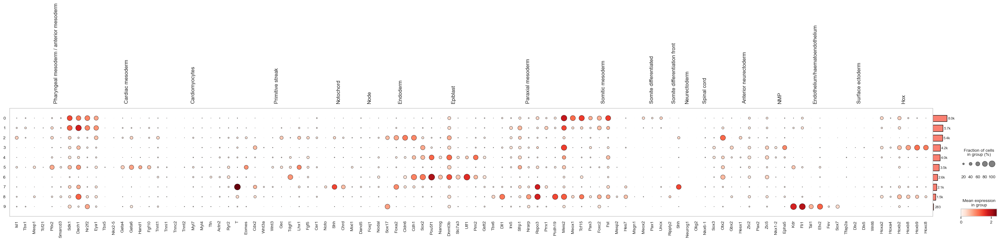

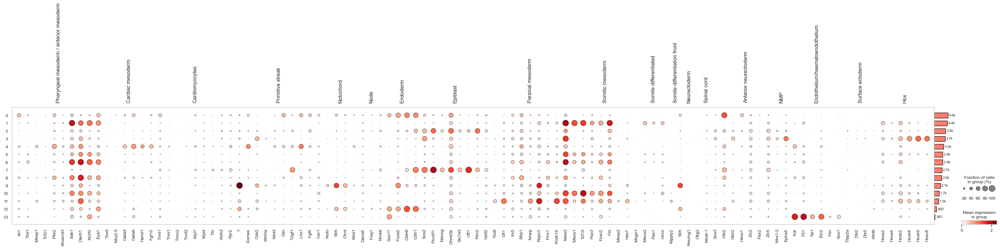

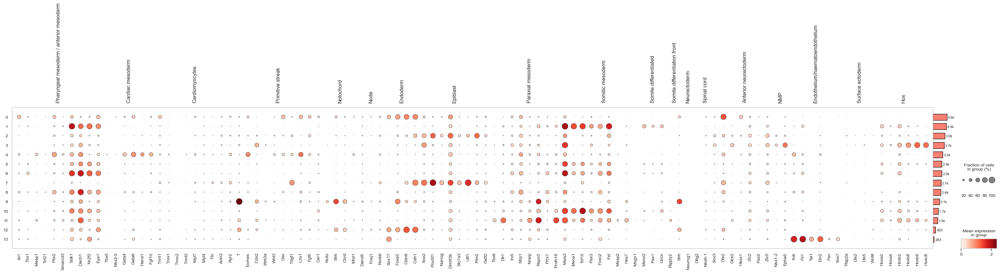

In [61]:
genes = {}
d = pd.read_csv("annotations.csv", header=None, sep=";")
for i in range(d.shape[0]):
    n = d.iloc[i,0]
    g = d.iloc[i,1]
    genes[n] = [j for j in (g.replace(" ","").replace("\t","").split(","))]

for resolution in parameters["resolutions"]:
    dp = scp.pl.dotplot(adata,var_names=genes,groupby=f"leiden_{resolution}", return_fig=True)
    dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()

    dp.savefig(f"figures/{dataset_name}/markers_dotplot_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

## Heatmap rescaled

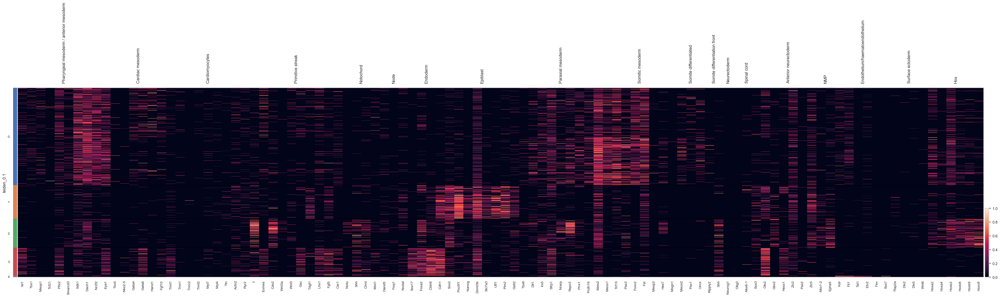

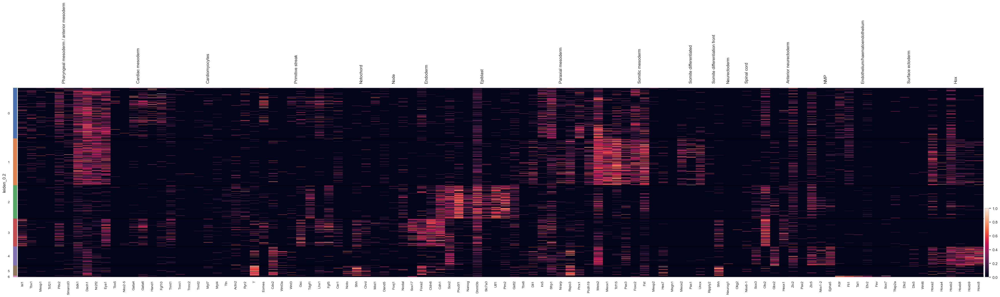

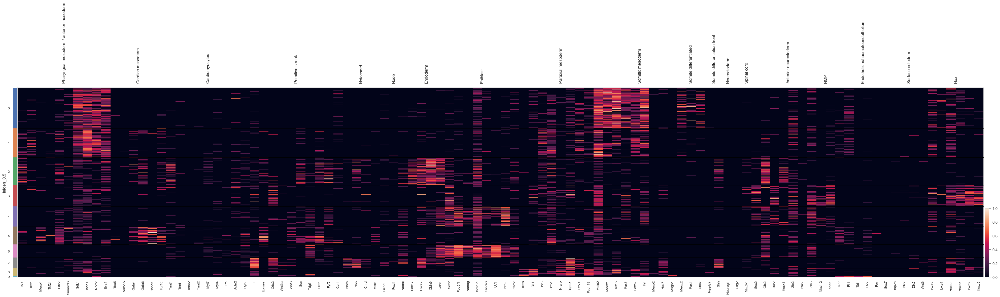

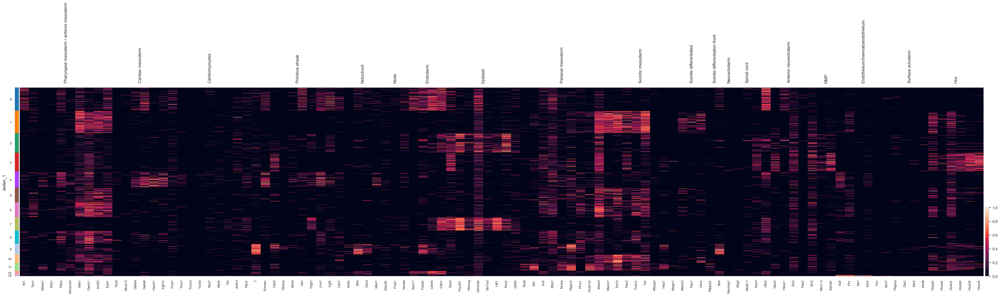

In [64]:
genes = {}
d = pd.read_csv("annotations.csv", header=None, sep=";")
for i in range(d.shape[0]):
    n = d.iloc[i,0]
    g = d.iloc[i,1]
    genes[n] = [j for j in (g.replace(" ","").replace("\t","").split(","))]

for resolution in parameters["resolutions"]:
    
    fig, dp = heatmap(adata,var_names=genes,groupby=f"leiden_{resolution}", standard_scale="var", figsize=(50,10), show_gene_labels=True, show=False)

    fig.savefig(f"figures/{dataset_name}/markers_heatmap_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

# Differential expression

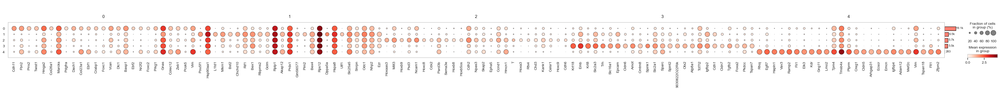

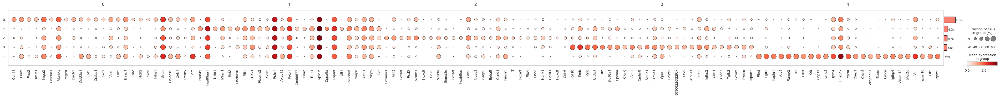

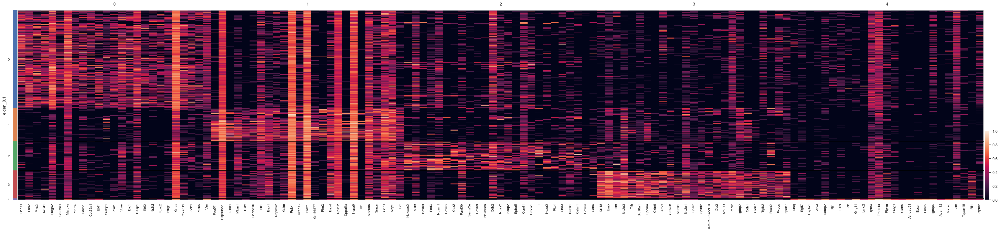

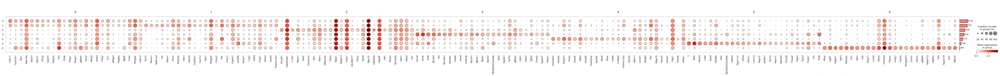

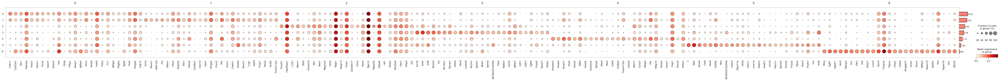

...

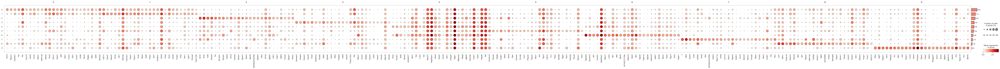

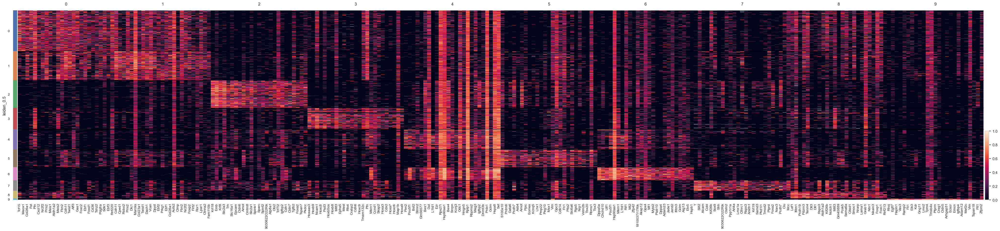

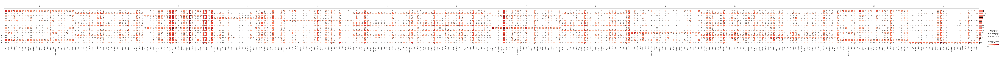

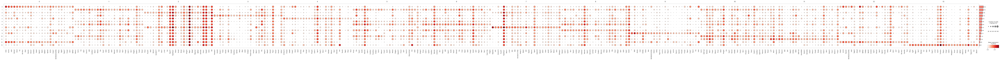

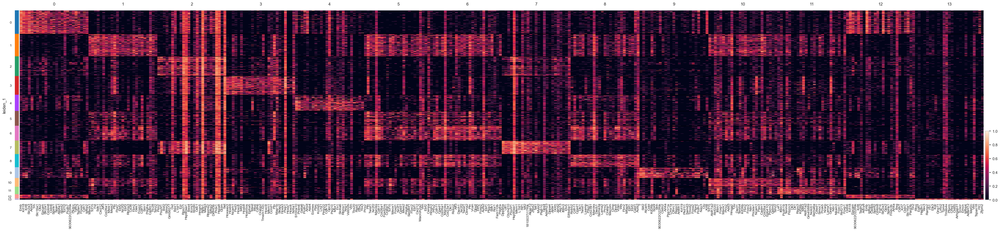

In [65]:
adata.layers["logcounts"] = adata.layers["counts"].log1p()
for resolution in parameters["resolutions"]:
    scp.tl.rank_genes_groups(adata, groupby=f"leiden_{resolution}", method="wilcoxon", layer="logcounts")

    with pd.ExcelWriter(f"tables/{dataset_name}/leiden_{resolution}.xlsx") as writer:
        for cluster in adata.obs[f"leiden_{resolution}"].cat.categories:
            genes = adata.uns["rank_genes_groups"]["names"][f"{cluster}"]
            scores = adata.uns["rank_genes_groups"]["scores"][f"{cluster}"]
            logfoldchanges = adata.uns["rank_genes_groups"]["logfoldchanges"][f"{cluster}"]
            pvals = adata.uns["rank_genes_groups"]["pvals"][f"{cluster}"]
            pvals_adj = adata.uns["rank_genes_groups"]["pvals_adj"][f"{cluster}"]
            df = pd.DataFrame({"gene": genes, "score": scores, "logfoldchange": logfoldchanges, "pval": pvals, "pval_adj": pvals_adj})
            df.to_excel(writer, sheet_name=f"cluster_{cluster}", index=False)

    genes = {}
    for cluster in adata.obs[f"leiden_{resolution}"].cat.categories:
        genes[cluster] = adata.uns["rank_genes_groups"]["names"][f"{cluster}"][:25]

    dp = scp.pl.dotplot(adata,var_names=genes,groupby=f"leiden_{resolution}", return_fig=True)
    dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()
    dp.savefig(f"figures/{dataset_name}/DE_dotplot_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

    fig, dp = heatmap(adata,var_names=genes,groupby=f"leiden_{resolution}", standard_scale="var", figsize=(50,10), show_gene_labels=True, show=False)
    fig.savefig(f"figures/{dataset_name}/DE_heatmap_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)


# Differential expression

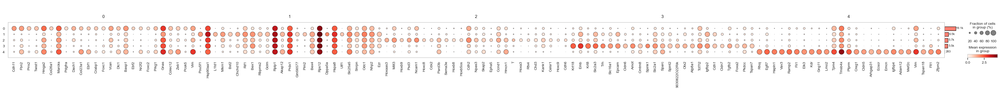

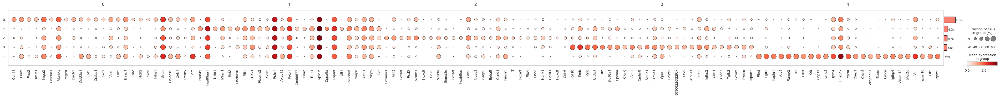

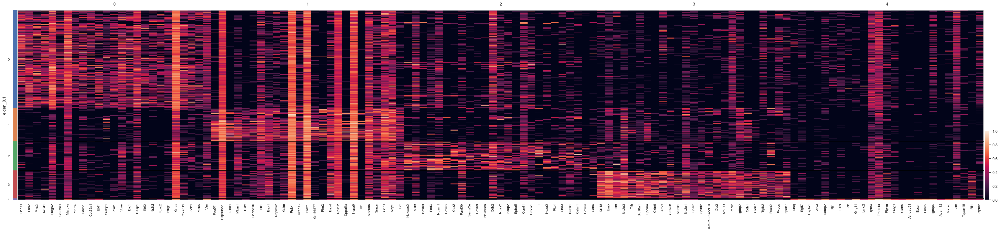

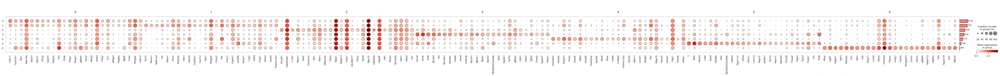

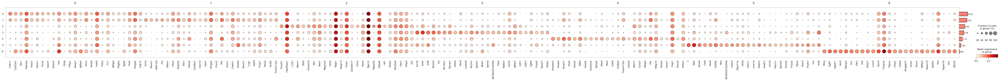

...

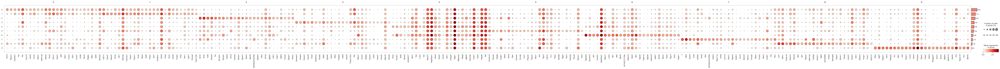

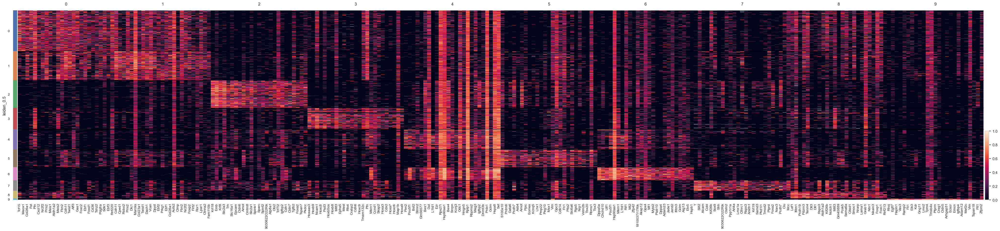

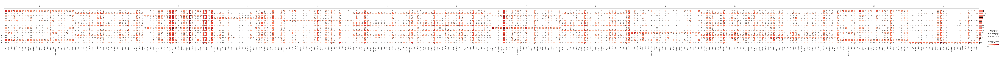

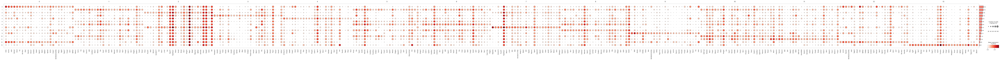

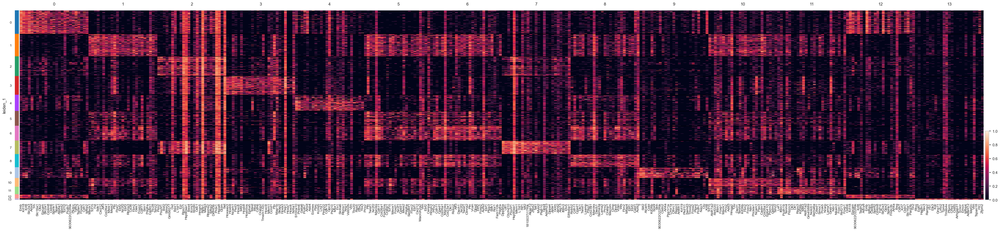

In [66]:
adata.layers["logcounts"] = adata.layers["counts"].log1p()
for resolution in parameters["resolutions"]:
    scp.tl.rank_genes_groups(adata, groupby=f"leiden_{resolution}", method="wilcoxon", layer="logcounts")

    with pd.ExcelWriter(f"tables/{dataset_name}/leiden_{resolution}.xlsx") as writer:
        for cluster in adata.obs[f"leiden_{resolution}"].cat.categories:
            genes = adata.uns["rank_genes_groups"]["names"][f"{cluster}"]
            scores = adata.uns["rank_genes_groups"]["scores"][f"{cluster}"]
            logfoldchanges = adata.uns["rank_genes_groups"]["logfoldchanges"][f"{cluster}"]
            pvals = adata.uns["rank_genes_groups"]["pvals"][f"{cluster}"]
            pvals_adj = adata.uns["rank_genes_groups"]["pvals_adj"][f"{cluster}"]
            df = pd.DataFrame({"gene": genes, "score": scores, "logfoldchange": logfoldchanges, "pval": pvals, "pval_adj": pvals_adj})
            df.to_excel(writer, sheet_name=f"cluster_{cluster}", index=False)

    genes = {}
    for cluster in adata.obs[f"leiden_{resolution}"].cat.categories:
        genes[cluster] = adata.uns["rank_genes_groups"]["names"][f"{cluster}"][:25]

    dp = scp.pl.dotplot(adata,var_names=genes,groupby=f"leiden_{resolution}", return_fig=True)
    dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()
    dp.savefig(f"figures/{dataset_name}/DE_dotplot_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

    fig, dp = heatmap(adata,var_names=genes,groupby=f"leiden_{resolution}", standard_scale="var", figsize=(50,10), show_gene_labels=True, show=False)
    fig.savefig(f"figures/{dataset_name}/DE_heatmap_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)


# Density by sample

/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_16987/3709163369.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_counts = adata.obs.groupby(["sample", f"leiden_{resolution}"]).size().unstack(fill_value=0)
/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_16987/3709163369.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_counts = adata.obs.groupby(["sample", f"leiden_{resolution}"]).size().unstack(fill_value=0)
/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_16987/3709163369.py:3: FutureWarning: The default of observed=False is deprecated and will be changed

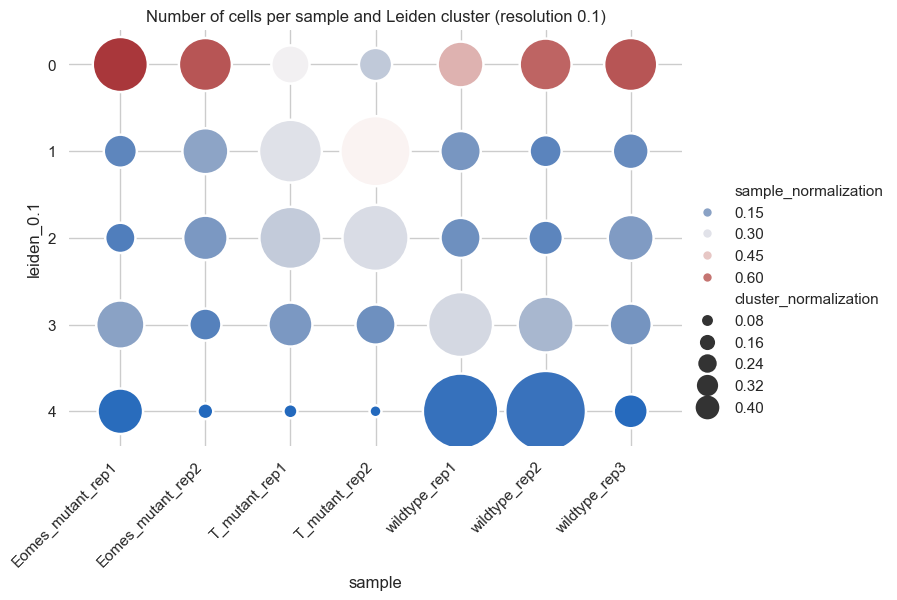

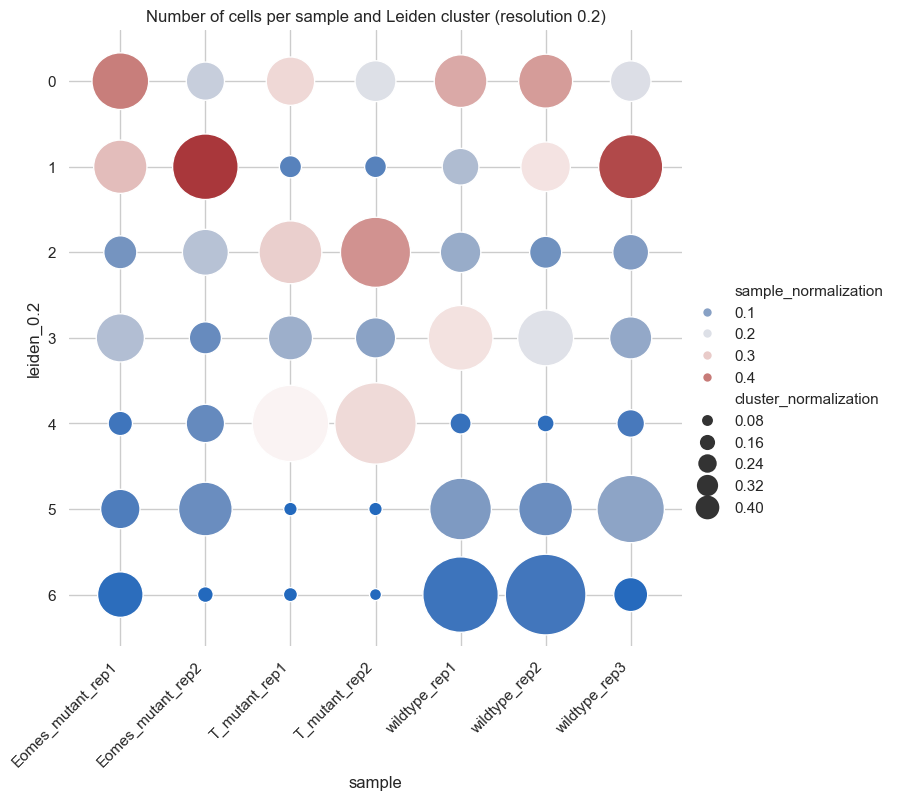

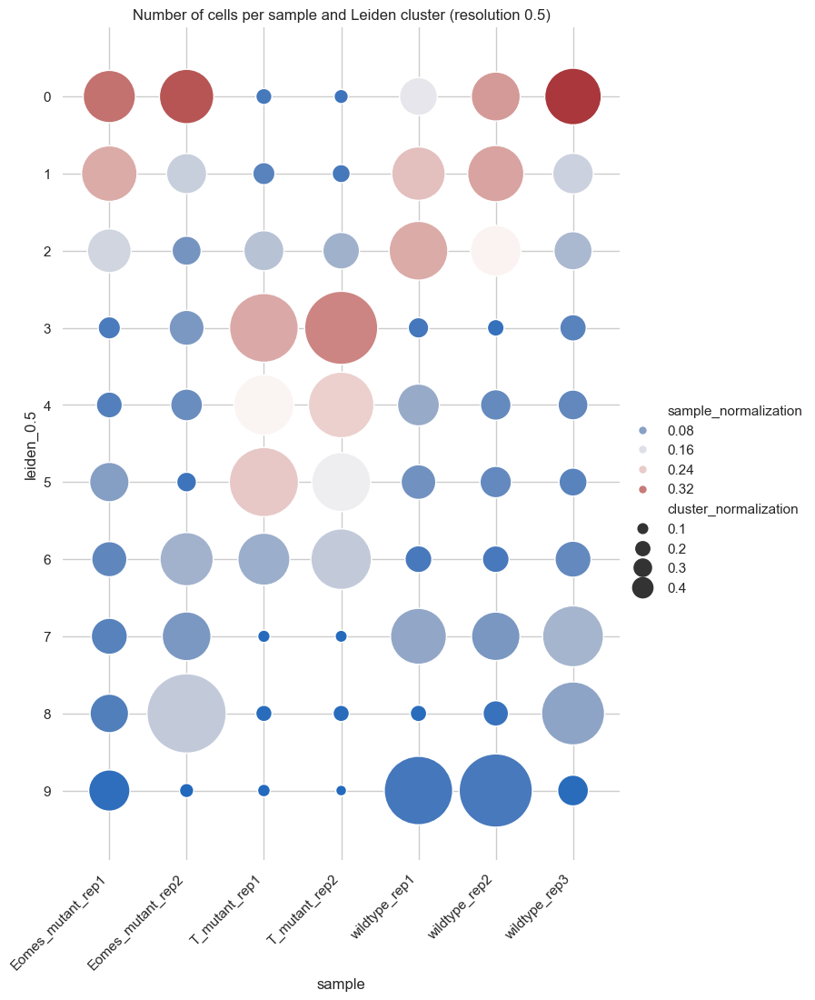

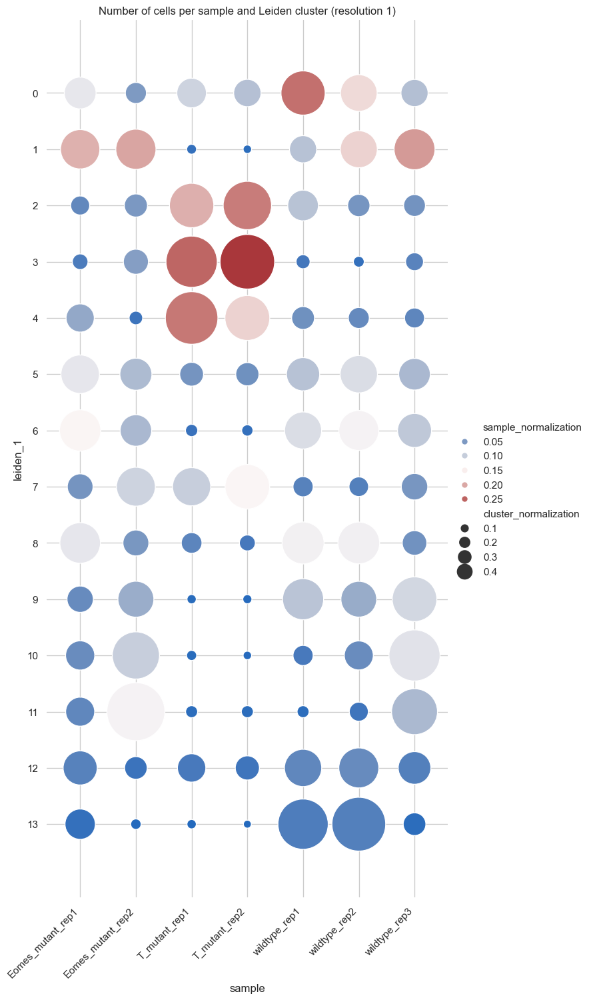

In [67]:
for resolution in parameters["resolutions"]:
    sns.set_theme(style="whitegrid")
    cluster_counts = adata.obs.groupby(["sample", f"leiden_{resolution}"]).size().unstack(fill_value=0)
    shape = cluster_counts.shape
    cluster_counts = cluster_counts.div(cluster_counts.sum(axis=1), axis=0)
    cluster_counts_ = cluster_counts.div(cluster_counts.sum(axis=0), axis=1)
    cluster_counts = cluster_counts.reset_index().melt(id_vars="sample", var_name=f"leiden_{resolution}", value_name="sample_normalization")
    cluster_counts_ = cluster_counts_.reset_index().melt(id_vars="sample", var_name=f"leiden_{resolution}", value_name="cluster_normalization")
    cluster_counts["cluster_normalization"] = cluster_counts_["cluster_normalization"].values
    aspect = shape[0]/shape[1]
    obj = sns.relplot(data=cluster_counts, x="sample", y=f"leiden_{resolution}", 
                      hue="sample_normalization", size="cluster_normalization", 
                      kind="scatter", height=shape[1], aspect=aspect, palette="vlag", 
                      sizes=(50, 8000), size_norm=(0, 1))#, hue_norm=(0, 1))
    for legend_handle in obj.legend.legend_handles:
        legend_handle.set_markersize(max(6,legend_handle.get_markersize()*0.3))

    plt.xticks(rotation=45, ha='right')
    plt.title(f"Number of cells per sample and Leiden cluster (resolution {resolution})")
    obj.ax.margins(.1)
    obj.despine(left=True, bottom=True)
    plt.savefig(f"figures/{dataset_name}/clustermap_leiden_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)

# Density by Condition

/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_16987/3120076028.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_counts = adata.obs.groupby(["condition", f"leiden_{resolution}"]).size().unstack(fill_value=0)
/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_16987/3120076028.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_counts = adata.obs.groupby(["condition", f"leiden_{resolution}"]).size().unstack(fill_value=0)
/var/folders/t9/0pk458_94qv27021t99vs5fr0000gn/T/ipykernel_16987/3120076028.py:3: FutureWarning: The default of observed=False is deprecated and will be c

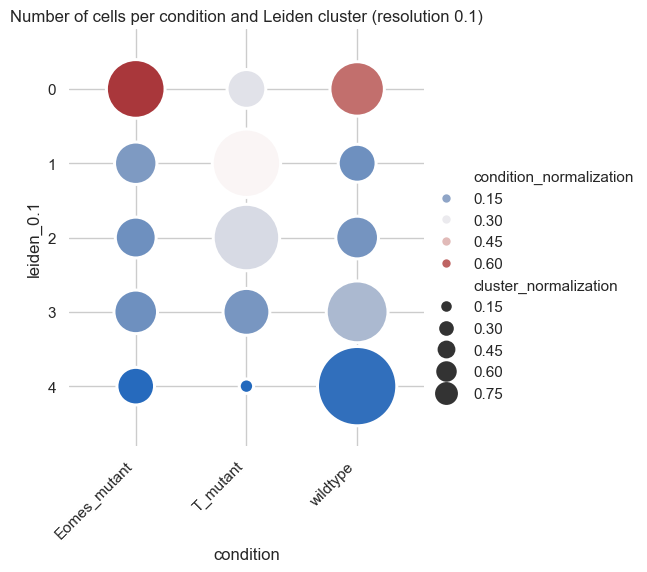

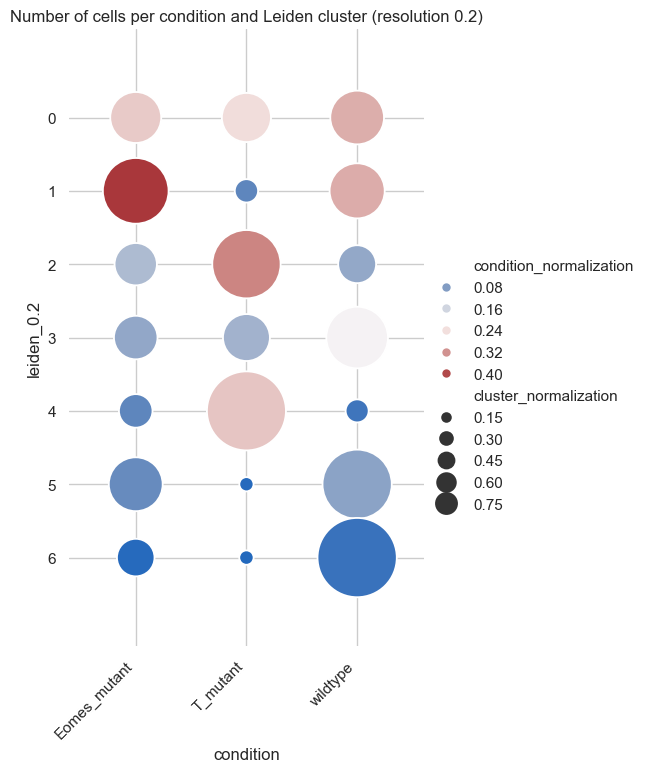

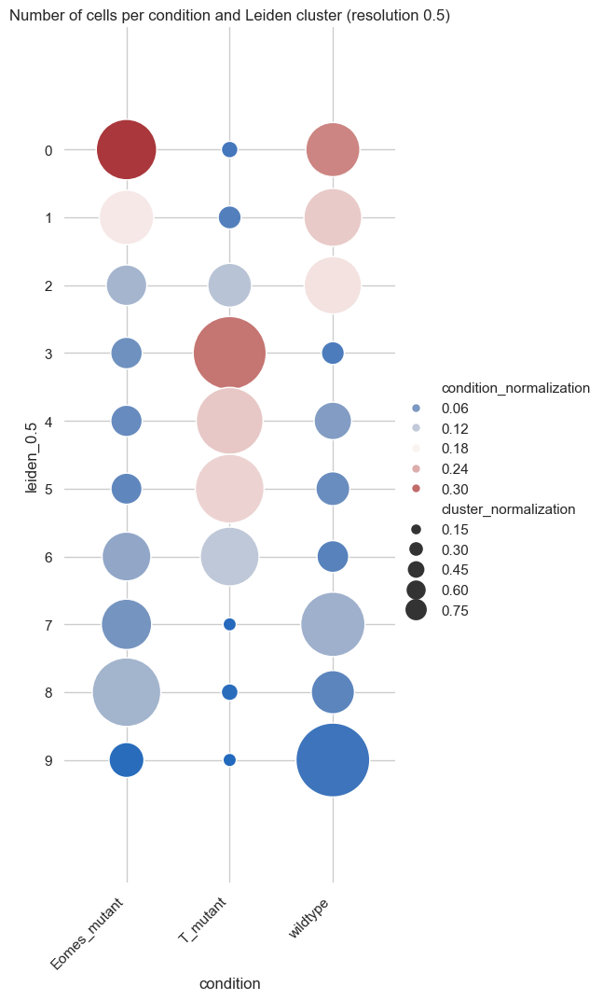

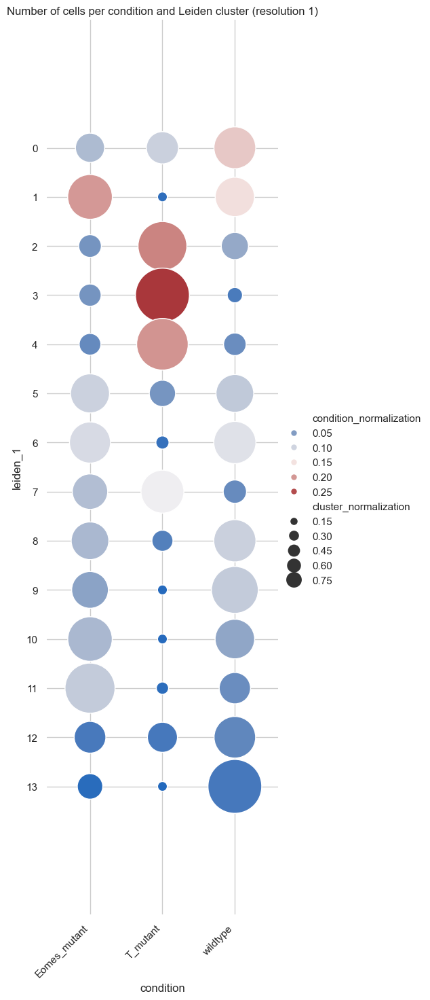

In [68]:
for resolution in parameters["resolutions"]:
    sns.set_theme(style="whitegrid")
    cluster_counts = adata.obs.groupby(["condition", f"leiden_{resolution}"]).size().unstack(fill_value=0)
    shape = cluster_counts.shape
    cluster_counts = cluster_counts.div(cluster_counts.sum(axis=1), axis=0)
    cluster_counts_ = cluster_counts.div(cluster_counts.sum(axis=0), axis=1)
    cluster_counts = cluster_counts.reset_index().melt(id_vars="condition", var_name=f"leiden_{resolution}", value_name="condition_normalization")
    cluster_counts_ = cluster_counts_.reset_index().melt(id_vars="condition", var_name=f"leiden_{resolution}", value_name="cluster_normalization")
    cluster_counts["cluster_normalization"] = cluster_counts_["cluster_normalization"].values
    aspect = shape[0]/shape[1]*1.5
    obj = sns.relplot(data=cluster_counts, x="condition", y=f"leiden_{resolution}", 
                      hue="condition_normalization", size="cluster_normalization", 
                      kind="scatter", height=shape[1], aspect=aspect, palette="vlag", 
                      sizes=(50, 4000), size_norm=(0, 1))#, hue_norm=(0, 1))
    for legend_handle in obj.legend.legend_handles:
        legend_handle.set_markersize(max(6,legend_handle.get_markersize()*0.3))

    plt.xticks(rotation=45, ha='right')
    plt.title(f"Number of cells per condition and Leiden cluster (resolution {resolution})")
    obj.ax.margins(.3,0.2)
    obj.despine(left=True, bottom=True)
    plt.savefig(f"figures/{dataset_name}/clustermap_leiden_{resolution}.png", bbox_inches="tight", transparent=True, dpi=300)





# Save 

## Adata object

In [69]:
adata.write(f"data_processed/adata_{dataset_name}.h5ad")

## Save analysis script

In [77]:
# Get the current date
current_date = datetime.now().strftime("%Y%m%d")

# Construct the output file name with the current date
input_file = f"analysis_full.ipynb"
output_file = f"script_versions/analysis_full_{current_date}"

# Convert the notebook to HTML with the new file name
!jupyter nbconvert --to html "$input_file" --output "$output_file"


[NbConvertApp] Converting notebook analysis_full.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 56 image(s).
[NbConvertApp] Writing 32426476 bytes to script_versions/analysis_full_20250516.html
